# Coral Bleaching Detection - Image Transformations Demo

This notebook demonstrates the various image processing and augmentation techniques used in the improved coral bleaching detection model. We'll visualize how each transformation affects underwater coral images.

## Overview of Transformations

The model uses several categories of transformations:
1. **Geometric Transformations** - Rotation, flipping, cropping
2. **Color Augmentation** - Brightness, contrast, hue adjustments
3. **Underwater-Specific Processing** - CLAHE, noise simulation
4. **Robustness Augmentation** - Blur, occlusion simulation


In [1]:
import os
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import cv2
import albumentations as A
from albumentations.pytorch import ToTensorV2
import random
from pathlib import Path

# Set random seed for reproducibility
random.seed(42)
np.random.seed(42)

# Configure matplotlib
plt.rcParams['figure.figsize'] = (15, 10)
plt.rcParams['font.size'] = 12


/Users/nishantsushmakar/Documents/TUe/capstone_challenge/Data-Capstone-Challenge/coral/lib/python3.13/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


## Load Sample Images

Let's load some sample coral images from the dataset to demonstrate the transformations.


In [2]:
# Define paths
image_dir = 'data/images'
bleached_mask_dir = 'data/masks_bleached'
non_bleached_mask_dir = 'data/masks_non_bleached'

# Get sample image files
image_files = [f for f in os.listdir(image_dir) if f.endswith('.jpg')][:4]
print(f"Found {len(image_files)} sample images")

# Load sample images
sample_images = []
sample_masks = []

for img_file in image_files:
    img_id = img_file.split('.')[0]
    
    # Load image
    img_path = os.path.join(image_dir, img_file)
    image = np.array(Image.open(img_path).convert('RGB'))
    
    # Load masks
    bleached_mask_path = os.path.join(bleached_mask_dir, f"{img_id}_bleached.png")
    non_bleached_mask_path = os.path.join(non_bleached_mask_dir, f"{img_id}_non_bleached.png")
    
    if os.path.exists(bleached_mask_path) and os.path.exists(non_bleached_mask_path):
        bleached_mask = np.array(Image.open(bleached_mask_path).convert('L'))
        non_bleached_mask = np.array(Image.open(non_bleached_mask_path).convert('L'))
        
        # Create segmentation mask
        seg_mask = np.zeros_like(bleached_mask, dtype=np.int64)
        seg_mask[non_bleached_mask > 127] = 1  # Healthy coral
        seg_mask[bleached_mask > 127] = 2      # Bleached coral
        
        sample_images.append(image)
        sample_masks.append(seg_mask)

print(f"Loaded {len(sample_images)} images with masks")


Found 4 sample images
Loaded 4 images with masks


## Define Individual Transformations

Let's define each transformation individually so we can see their effects separately.


In [18]:
# Individual transformations for demonstration
transformations = {
    'Original': None,
    
    # Geometric transformations
    'RandomResizedCrop': A.RandomResizedCrop(size=(512, 512), scale=(0.7, 1.0), p=1.0),
    'HorizontalFlip': A.HorizontalFlip(p=1.0),
    'VerticalFlip': A.VerticalFlip(p=1.0),
    'RandomRotate90': A.RandomRotate90(p=1.0),
    'Affine': A.Affine(translate_percent=0.1, scale=(0.8, 1.2), rotate=(-30, 30), p=1.0),
    
    # Color augmentations
    'RandomBrightnessContrast': A.RandomBrightnessContrast(brightness_limit=0.3, contrast_limit=0.3, p=1.0),
    'HueSaturationValue': A.HueSaturationValue(hue_shift_limit=20, sat_shift_limit=30, val_shift_limit=20, p=1.0),
    'RGBShift': A.RGBShift(r_shift_limit=20, g_shift_limit=20, b_shift_limit=20, p=1.0),
    'RandomGamma': A.RandomGamma(gamma_limit=(70, 130), p=1.0),
    'CLAHE': A.CLAHE(clip_limit=4.0, p=1.0),
    'ColorJitter': A.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.1, p=1.0),
    
    # Noise and blur (underwater conditions)
    'GaussNoise': A.GaussNoise(std_range=(0.01, 0.05), mean_range=(0.0, 0.0), p=1.0),
    'GaussianBlur': A.GaussianBlur(blur_limit=(3, 5), p=1.0),
    'MedianBlur': A.MedianBlur(blur_limit=3, p=1.0),
    'MotionBlur': A.MotionBlur(blur_limit=5, p=1.0),
    
    # Occlusion
    'CoarseDropout': A.CoarseDropout(
        num_holes_range=(5, 10),
        hole_height_range=(32, 64),
        hole_width_range=(32, 64),
        fill=0,
        p=1.0
    ),
    
    # Normalization
    'Normalize': A.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
}

print(f"Defined {len(transformations)} transformations")


Defined 18 transformations


## Visualization Functions

Create functions to visualize the effects of transformations.


In [13]:
def apply_transformation(image, mask, transform):
    """Apply a transformation to image and mask"""
    if transform is None:
        return image, mask
    
    try:
        transformed = transform(image=image, mask=mask)
        return transformed['image'], transformed['mask']
    except Exception as e:
        print(f"Error applying transformation: {e}")
        return image, mask

def visualize_transformations(image, mask, transformations_dict, max_cols=4):
    """Visualize multiple transformations on a single image"""
    n_transforms = len(transformations_dict)
    n_rows = (n_transforms + max_cols - 1) // max_cols
    
    fig, axes = plt.subplots(n_rows, max_cols, figsize=(max_cols * 4, n_rows * 4))
    if n_rows == 1:
        axes = axes.reshape(1, -1)
    
    for idx, (name, transform) in enumerate(transformations_dict.items()):
        row = idx // max_cols
        col = idx % max_cols
        
        # Apply transformation
        transformed_img, transformed_mask = apply_transformation(image, mask, transform)
        
        # Display image
        axes[row, col].imshow(transformed_img)
        axes[row, col].set_title(f'{name}', fontsize=20, fontweight='bold')
        axes[row, col].axis('off')
    
    # Hide unused subplots
    for idx in range(n_transforms, n_rows * max_cols):
        row = idx // max_cols
        col = idx % max_cols
        axes[row, col].axis('off')
    
    plt.tight_layout()
    plt.show()

def visualize_with_masks(image, mask, transform_name, transform):
    """Visualize transformation effects on both image and segmentation mask"""
    transformed_img, transformed_mask = apply_transformation(image, mask, transform)
    
    fig, axes = plt.subplots(2, 2, figsize=(12, 10))
    
    # Original image and mask
    axes[0, 0].imshow(image)
    axes[0, 0].set_title('Original Image', fontweight='bold')
    axes[0, 0].axis('off')
    
    axes[0, 1].imshow(mask, cmap='tab10', vmin=0, vmax=2)
    axes[0, 1].set_title('Original Mask\n(0=Background, 1=Healthy, 2=Bleached)', fontweight='bold')
    axes[0, 1].axis('off')
    
    # Transformed image and mask
    axes[1, 0].imshow(transformed_img)
    axes[1, 0].set_title(f'Transformed Image\n({transform_name})', fontweight='bold')
    axes[1, 0].axis('off')
    
    axes[1, 1].imshow(transformed_mask, cmap='tab10', vmin=0, vmax=2)
    axes[1, 1].set_title(f'Transformed Mask\n({transform_name})', fontweight='bold')
    axes[1, 1].axis('off')
    
    plt.tight_layout()
    plt.show()


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.6399999].


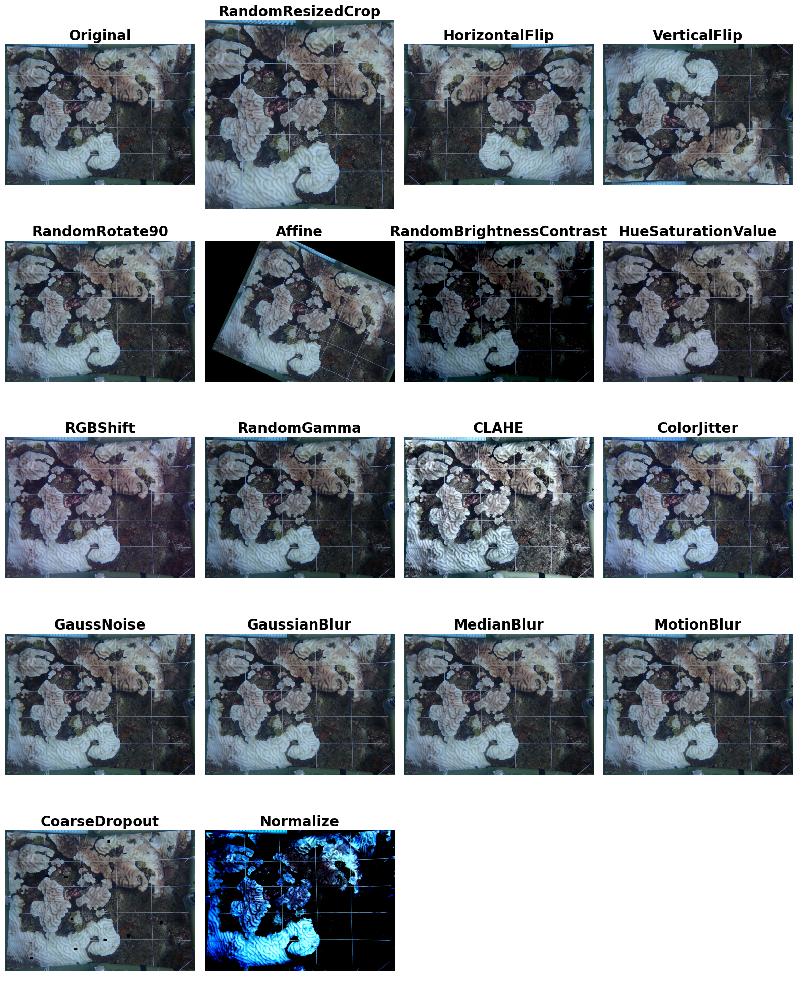

In [19]:
visualize_transformations(demo_image, demo_mask, transformations)

## 1. Geometric Transformations

These transformations change the spatial arrangement of the image while preserving the content.


=== GEOMETRIC TRANSFORMATIONS ===
These transformations change spatial arrangement while preserving content:
- RandomResizedCrop: Random cropping and resizing
- HorizontalFlip: Mirror image horizontally
- VerticalFlip: Mirror image vertically
- RandomRotate90: Random 90-degree rotations
- Affine: Translation, scaling, and rotation combined


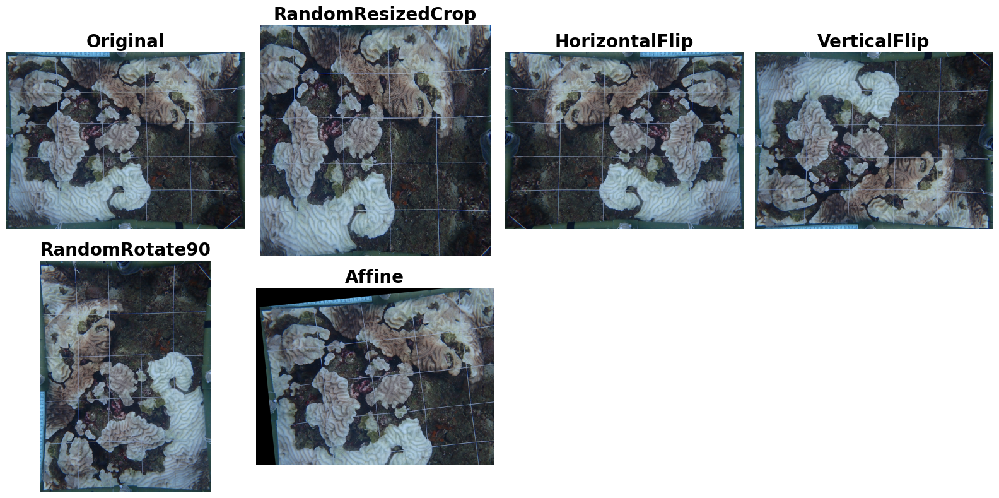

In [14]:
# Select first image for demonstration
demo_image = sample_images[0]
demo_mask = sample_masks[0]

# Geometric transformations
geometric_transforms = {
    'Original': None,
    'RandomResizedCrop': transformations['RandomResizedCrop'],a
    'HorizontalFlip': transformations['HorizontalFlip'],
    'VerticalFlip': transformations['VerticalFlip'],
    'RandomRotate90': transformations['RandomRotate90'],
    'Affine': transformations['Affine']
}

print("=== GEOMETRIC TRANSFORMATIONS ===")
print("These transformations change spatial arrangement while preserving content:")
print("- RandomResizedCrop: Random cropping and resizing")
print("- HorizontalFlip: Mirror image horizontally")
print("- VerticalFlip: Mirror image vertically")
print("- RandomRotate90: Random 90-degree rotations")
print("- Affine: Translation, scaling, and rotation combined")

visualize_transformations(demo_image, demo_mask, geometric_transforms)


## 2. Color Augmentations

These transformations modify color properties, crucial for handling underwater lighting variations.


=== COLOR AUGMENTATIONS ===
These transformations modify color properties for underwater conditions:
- RandomBrightnessContrast: Adjusts lighting levels
- HueSaturationValue: Changes color hue, saturation, and value
- RGBShift: Shifts individual RGB channels
- RandomGamma: Gamma correction for lighting
- CLAHE: Contrast Limited Adaptive Histogram Equalization (crucial for underwater)
- ColorJitter: Combined color adjustments


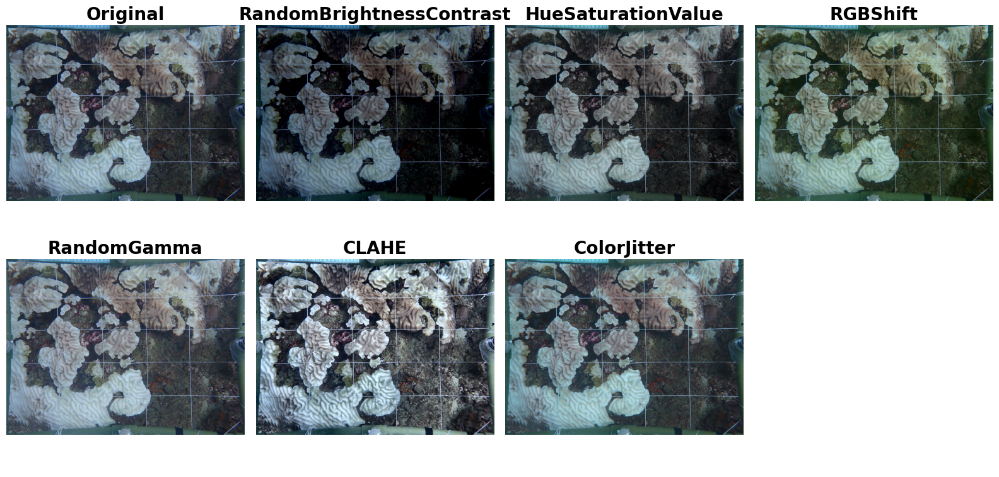

In [15]:
# Color transformations
color_transforms = {
    'Original': None,
    'RandomBrightnessContrast': transformations['RandomBrightnessContrast'],
    'HueSaturationValue': transformations['HueSaturationValue'],
    'RGBShift': transformations['RGBShift'],
    'RandomGamma': transformations['RandomGamma'],
    'CLAHE': transformations['CLAHE'],
    'ColorJitter': transformations['ColorJitter']
}

print("=== COLOR AUGMENTATIONS ===")
print("These transformations modify color properties for underwater conditions:")
print("- RandomBrightnessContrast: Adjusts lighting levels")
print("- HueSaturationValue: Changes color hue, saturation, and value")
print("- RGBShift: Shifts individual RGB channels")
print("- RandomGamma: Gamma correction for lighting")
print("- CLAHE: Contrast Limited Adaptive Histogram Equalization (crucial for underwater)")
print("- ColorJitter: Combined color adjustments")

visualize_transformations(demo_image, demo_mask, color_transforms)


## 3. Underwater-Specific Processing

These transformations simulate conditions specific to underwater photography.


=== UNDERWATER-SPECIFIC PROCESSING ===
These transformations simulate underwater photography conditions:
- GaussNoise: Simulates underwater particle scattering
- GaussianBlur: Simulates water turbidity
- MedianBlur: Simulates camera sensor noise
- MotionBlur: Simulates camera movement in water
- CoarseDropout: Simulates occlusions (fish, debris)


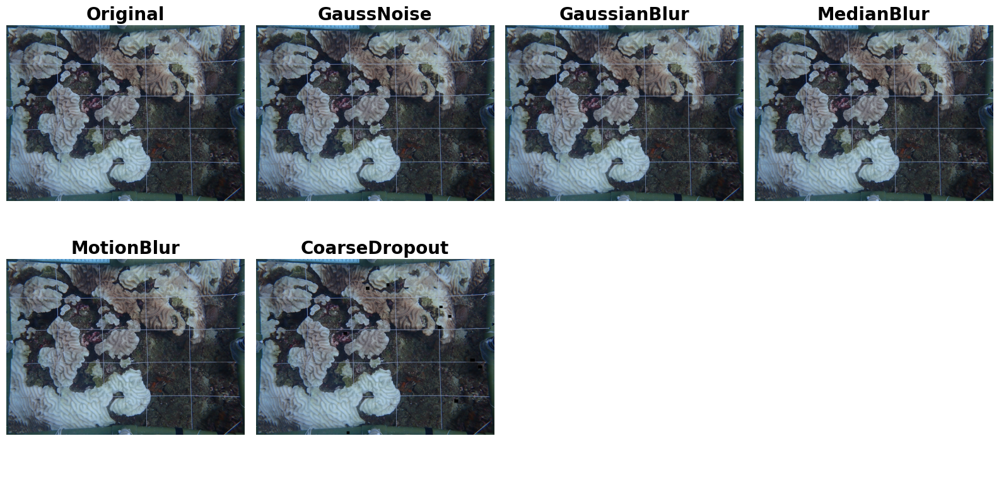

In [16]:
# Underwater-specific transformations
underwater_transforms = {
    'Original': None,
    'GaussNoise': transformations['GaussNoise'],
    'GaussianBlur': transformations['GaussianBlur'],
    'MedianBlur': transformations['MedianBlur'],
    'MotionBlur': transformations['MotionBlur'],
    'CoarseDropout': transformations['CoarseDropout']
}

print("=== UNDERWATER-SPECIFIC PROCESSING ===")
print("These transformations simulate underwater photography conditions:")
print("- GaussNoise: Simulates underwater particle scattering")
print("- GaussianBlur: Simulates water turbidity")
print("- MedianBlur: Simulates camera sensor noise")
print("- MotionBlur: Simulates camera movement in water")
print("- CoarseDropout: Simulates occlusions (fish, debris)")

visualize_transformations(demo_image, demo_mask, underwater_transforms)


## 4. Detailed Analysis: CLAHE (Contrast Limited Adaptive Histogram Equalization)

CLAHE is particularly important for underwater images. Let's see its effect in detail.


=== CLAHE DETAILED ANALYSIS ===
CLAHE enhances local contrast, crucial for underwater images where lighting is uneven.
It helps reveal details in both dark and bright regions.


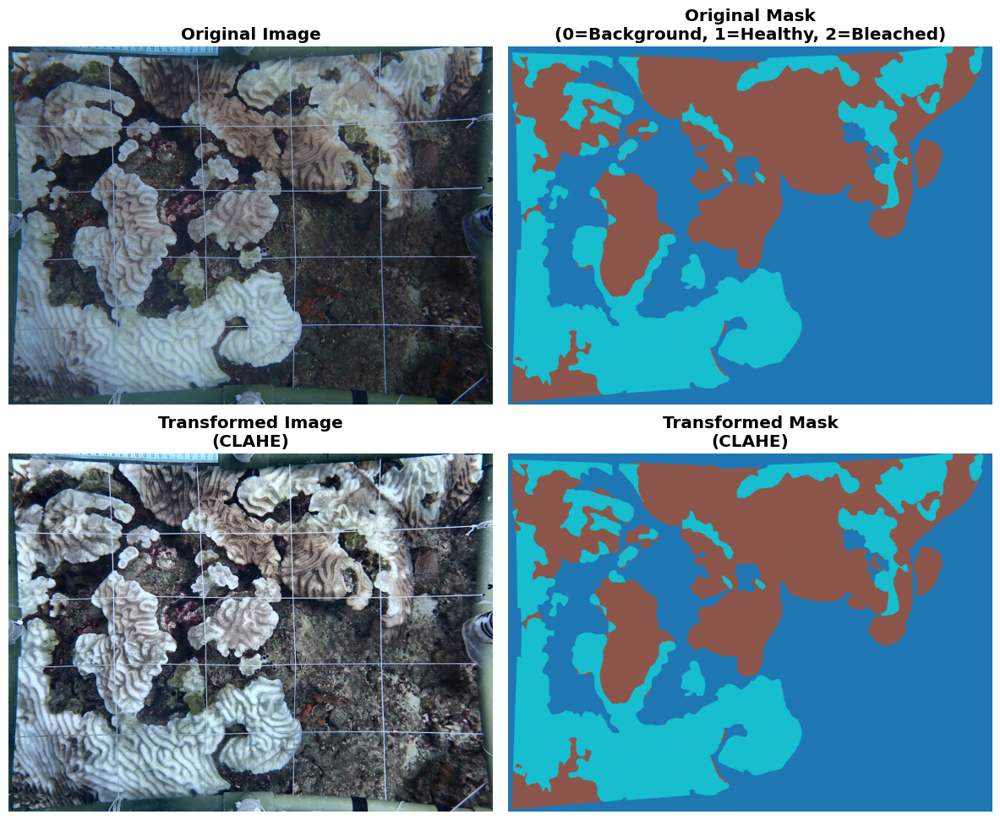

In [9]:
print("=== CLAHE DETAILED ANALYSIS ===")
print("CLAHE enhances local contrast, crucial for underwater images where lighting is uneven.")
print("It helps reveal details in both dark and bright regions.")

visualize_with_masks(demo_image, demo_mask, 'CLAHE', transformations['CLAHE'])


## 5. Combined Transformations

Let's see how multiple transformations work together, simulating the actual training pipeline.


=== COMBINED TRANSFORMATIONS ===
This shows the actual training pipeline with multiple transformations applied together.
Each run will produce different results due to random probabilities.


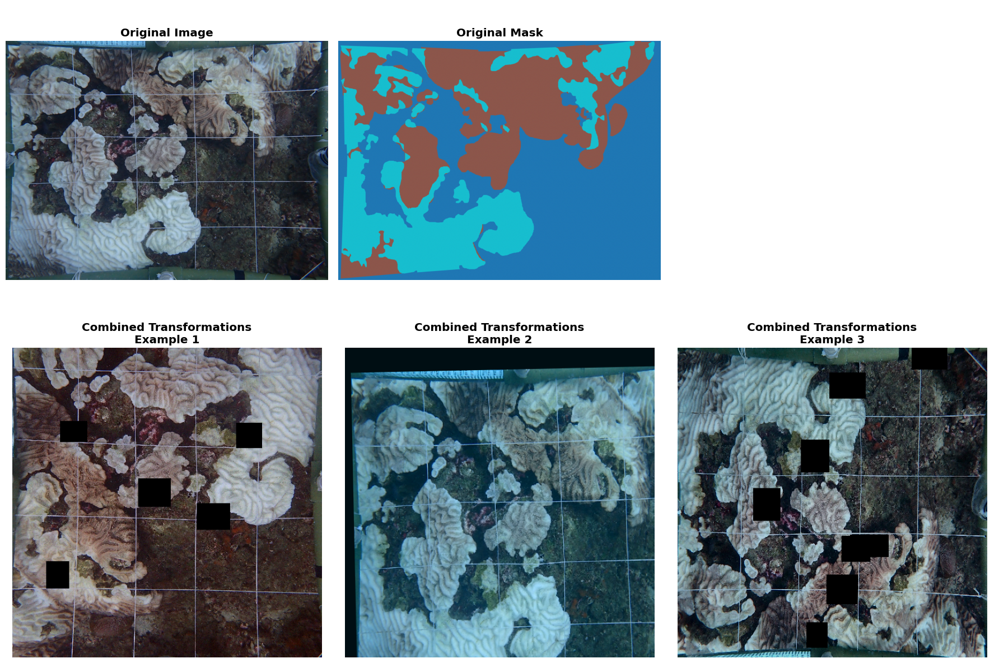

In [10]:
# Create a pipeline similar to the training pipeline
training_pipeline = A.Compose([
    # Geometric transforms
    A.RandomResizedCrop(size=(512, 512), scale=(0.7, 1.0), p=1.0),
    A.HorizontalFlip(p=0.5),
    A.VerticalFlip(p=0.5),
    A.RandomRotate90(p=0.5),
    A.Affine(translate_percent=0.1, scale=(0.8, 1.2), rotate=(-30, 30), p=0.5),
    
    # Color augmentation
    A.OneOf([
        A.RandomBrightnessContrast(brightness_limit=0.3, contrast_limit=0.3, p=1),
        A.HueSaturationValue(hue_shift_limit=20, sat_shift_limit=30, val_shift_limit=20, p=1),
        A.RGBShift(r_shift_limit=20, g_shift_limit=20, b_shift_limit=20, p=1),
        A.RandomGamma(gamma_limit=(70, 130), p=1),
        A.CLAHE(clip_limit=4.0, p=1),
    ], p=0.9),
    
    # Underwater conditions
    A.OneOf([
        A.GaussNoise(std_range=(0.01, 0.05), mean_range=(0.0, 0.0), p=1),
        A.GaussianBlur(blur_limit=(3, 5), p=1),
        A.MedianBlur(blur_limit=3, p=1),
        A.MotionBlur(blur_limit=5, p=1),
    ], p=0.4),

    # Color cast
    A.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.1, p=0.5),

    # Occlusion
    A.CoarseDropout(
        num_holes_range=(5, 10),
        hole_height_range=(32, 64),
        hole_width_range=(32, 64),
        fill=0,
        p=0.3
    ),
], additional_targets={'masks': 'masks'})

print("=== COMBINED TRANSFORMATIONS ===")
print("This shows the actual training pipeline with multiple transformations applied together.")
print("Each run will produce different results due to random probabilities.")

# Show multiple examples of the combined pipeline
fig, axes = plt.subplots(2, 3, figsize=(18, 12))

# Original
axes[0, 0].imshow(demo_image)
axes[0, 0].set_title('Original Image', fontweight='bold')
axes[0, 0].axis('off')

axes[0, 1].imshow(demo_mask, cmap='tab10', vmin=0, vmax=2)
axes[0, 1].set_title('Original Mask', fontweight='bold')
axes[0, 1].axis('off')

axes[0, 2].axis('off')  # Empty space

# Three examples of combined transformations
for i in range(3):
    transformed = training_pipeline(image=demo_image, mask=demo_mask)
    transformed_img = transformed['image']
    transformed_mask = transformed['mask']
    
    axes[1, i].imshow(transformed_img)
    axes[1, i].set_title(f'Combined Transformations\nExample {i+1}', fontweight='bold')
    axes[1, i].axis('off')

plt.tight_layout()
plt.show()


## 6. Multiple Sample Images

Let's see how transformations affect different coral images.


=== MULTIPLE SAMPLE IMAGES ===
Showing how transformations affect different coral reef images.

--- Sample Image 1 ---


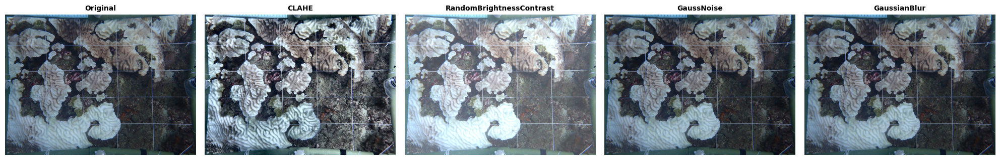


--- Sample Image 2 ---


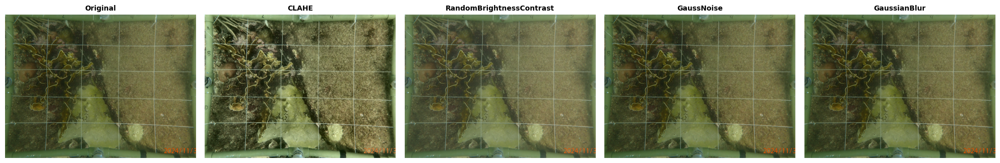


--- Sample Image 3 ---


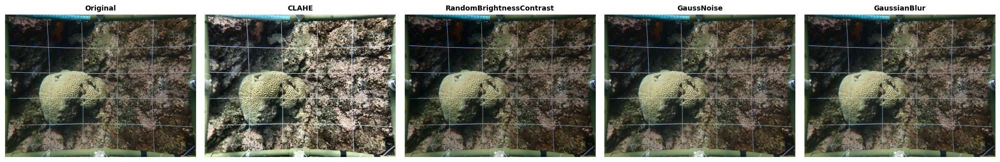

In [11]:
print("=== MULTIPLE SAMPLE IMAGES ===")
print("Showing how transformations affect different coral reef images.")

# Select a few key transformations to show on multiple images
key_transforms = {
    'Original': None,
    'CLAHE': transformations['CLAHE'],
    'RandomBrightnessContrast': transformations['RandomBrightnessContrast'],
    'GaussNoise': transformations['GaussNoise'],
    'GaussianBlur': transformations['GaussianBlur']
}

for i, (img, mask) in enumerate(zip(sample_images[:3], sample_masks[:3])):
    print(f"\n--- Sample Image {i+1} ---")
    visualize_transformations(img, mask, key_transforms, max_cols=5)


## 7. Before/After Comparison

Let's create a detailed before/after comparison for the most important transformations.


=== BEFORE/AFTER COMPARISON ===
Detailed comparison of key transformations.

--- CLAHE ---


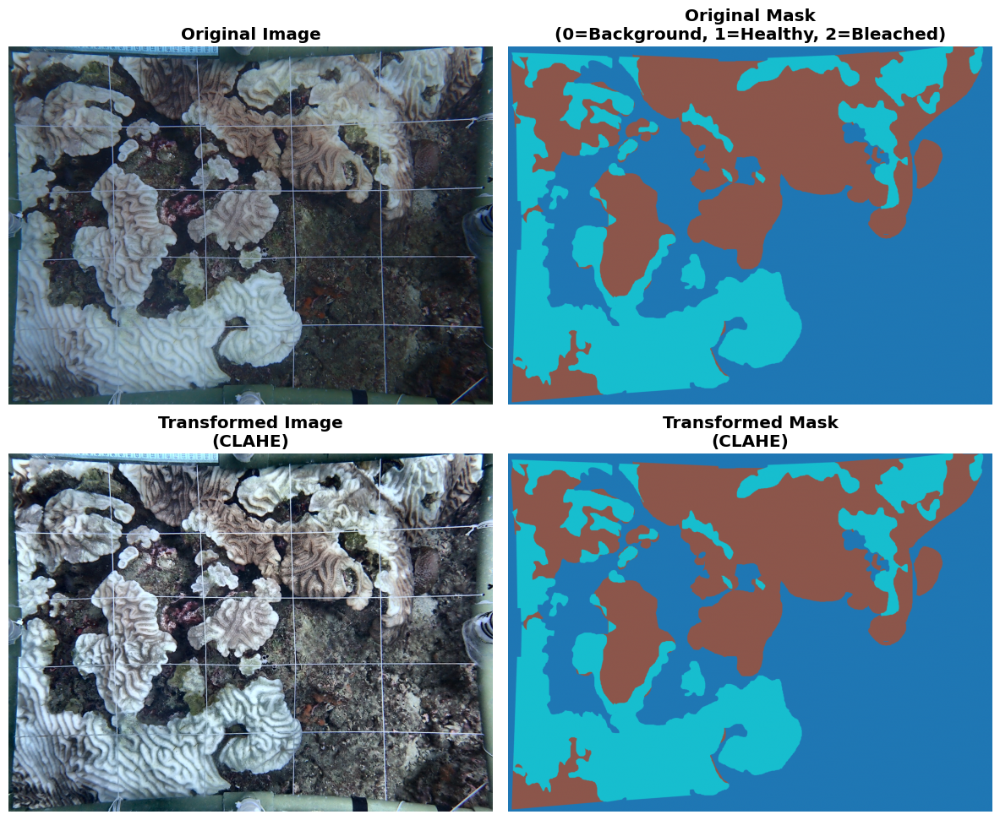


--- RandomBrightnessContrast ---


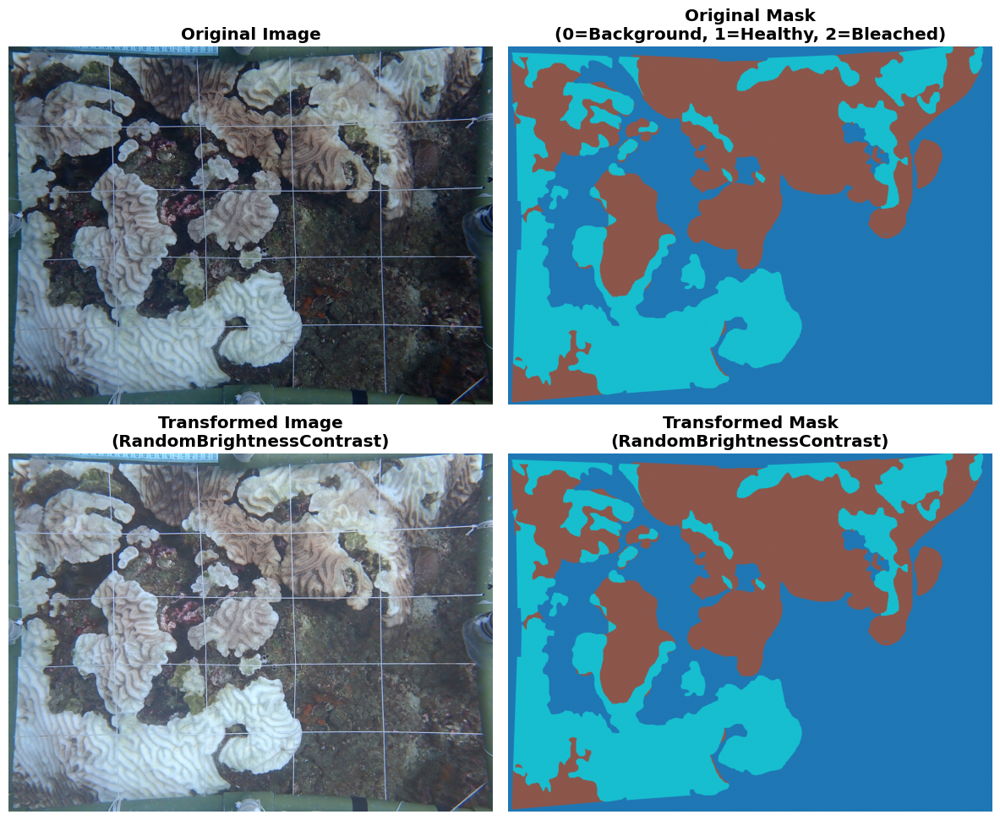


--- GaussNoise ---


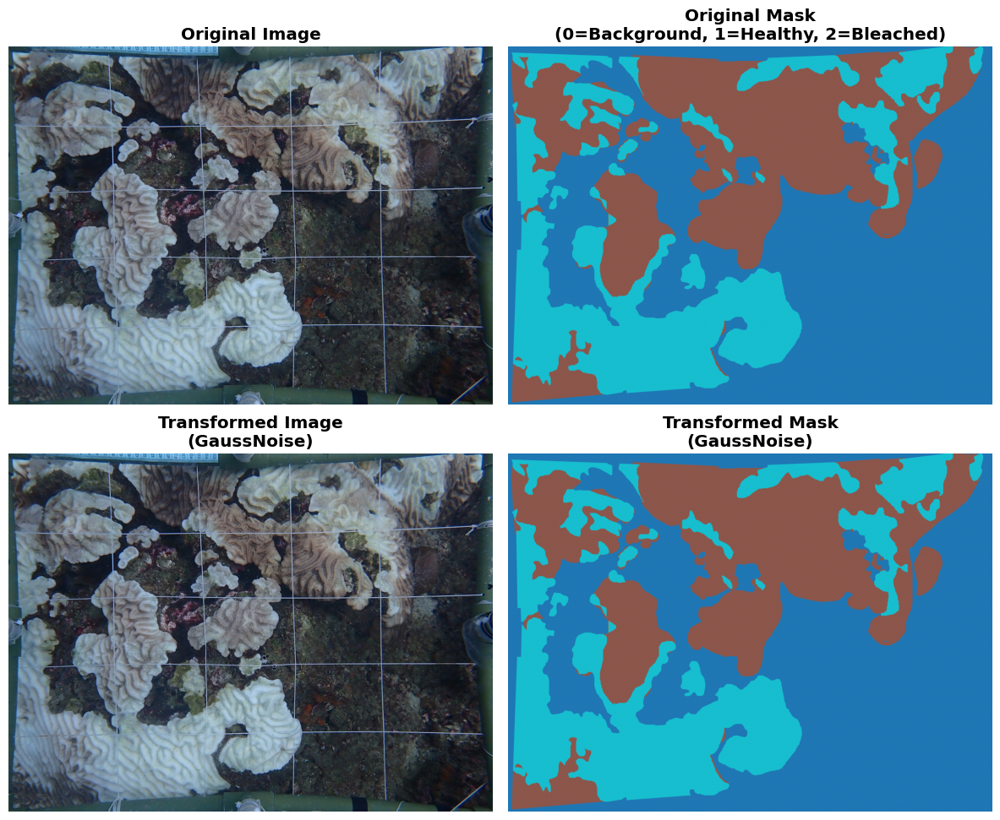


--- GaussianBlur ---


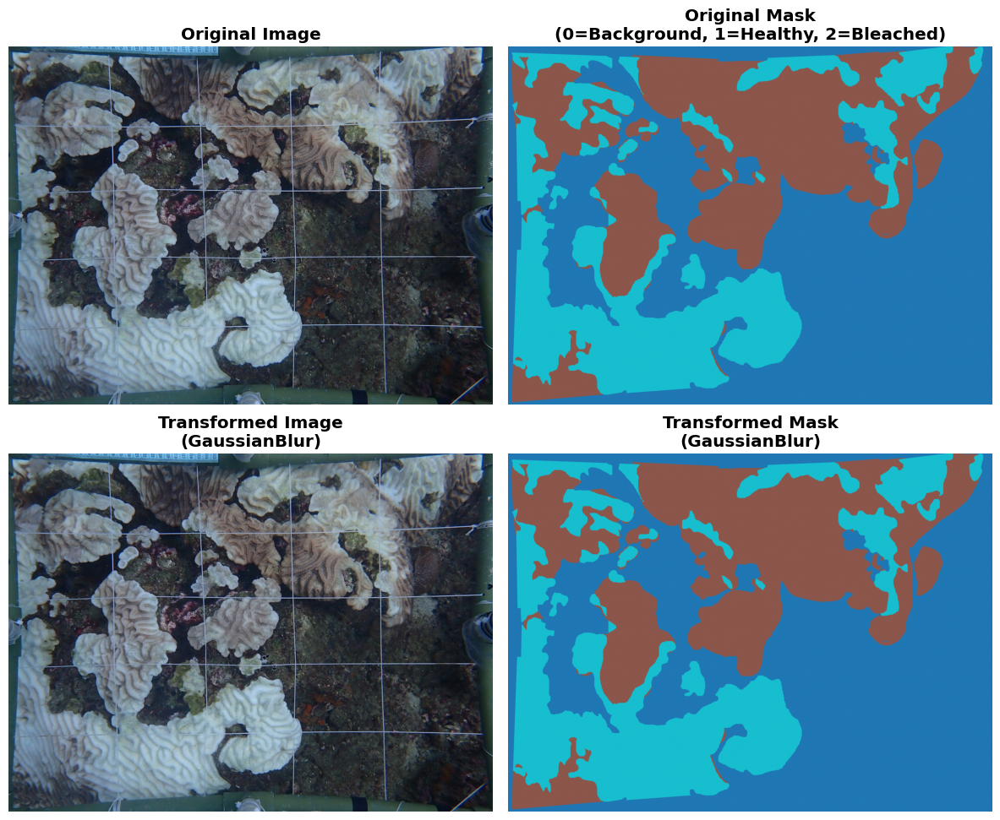

In [12]:
print("=== BEFORE/AFTER COMPARISON ===")
print("Detailed comparison of key transformations.")

# Select important transformations for detailed comparison
important_transforms = ['CLAHE', 'RandomBrightnessContrast', 'GaussNoise', 'GaussianBlur']

for transform_name in important_transforms:
    print(f"\n--- {transform_name} ---")
    visualize_with_masks(demo_image, demo_mask, transform_name, transformations[transform_name])


## Summary

### Key Insights:

1. **Geometric Transformations**: Help the model generalize to different orientations and scales
2. **Color Augmentations**: Essential for handling underwater lighting variations
3. **CLAHE**: Particularly important for underwater images with uneven lighting
4. **Noise and Blur**: Simulate real underwater photography conditions
5. **Combined Pipeline**: Creates robust training data that handles various underwater scenarios

### Why These Transformations Matter:

- **Underwater photography challenges**: Poor lighting, color distortion, particle scattering
- **Data augmentation**: Increases dataset diversity without collecting more images
- **Robustness**: Helps model generalize to real-world underwater conditions
- **Class balance**: Some transformations help with imbalanced coral health classes

The combination of these transformations ensures the coral bleaching detection model can handle the challenging conditions typical of underwater reef imagery.
